### Imports

In [1]:
import pandas as pd
import numpy as np
import geopandas as gpd

In [2]:
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib as mpl
%matplotlib inline 
mpl.rcParams['figure.dpi'] = 300

In [3]:
from sklearn.preprocessing import Normalizer

In [4]:
pd.options.display.max_rows = 4000
pd.options.display.max_columns = 4000

### Setup

In [ ]:
DATA_VERSION = 'v4'

In [5]:
fig_dir = '../' + DATA_VERSION + '-fig/SCCS/fig-cgis-no-eu/SCCS/'

In [6]:
cgi_csv = '../data/' + DATA_VERSION + '/institutions_data_prepped.csv'

In [7]:
cgi_df = pd.read_csv(cgi_csv)

In [8]:
cgi_df.head()

,Institution_Name,Community_Name,Mechanism,Notes,Time span,Geography,Size,Source,Heterogeneity,Time span: Start,Time span: End,enforcement_mechanisms_include_graduated_sanctions,access_mechanisms_include_dreaming,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_board_committee,enforcement_mechanisms_include_tribunal_court_,enforcement_mechanisms_include_civil_disobedience,decision_making_mechanisms_include_vote_by_show_of_hands,decision_making_mechanisms_include_remunerated_position,access_mechanisms_include_life_appointment,decision_making_mechanisms_include_deliberation,decision_making_mechanisms_include_assembly_local,enforcement_mechanisms_include_mediation,decision_making_mechanisms_include_leader_first_among_equals,access_mechanisms_include_enfranchisement,decision_making_mechanisms_include_autocratic_leader_chief_bound,decision_making_mechanisms_include_assembly_central,decision_making_mechanisms_include_alliance,access_mechanisms_include_heredity,access_mechanisms_include_election,decision_making_mechanisms_include_magistrate_official,decision_making_mechanisms_include_ratification_acclamation_only,enforcement_mechanisms_include_reputational_risk,decision_making_mechanisms_include_veto,decision_making_mechanisms_include_unanimity,enforcement_mechanisms_include_criticism_mocking_joking,decision_making_mechanisms_include_agenda_setting,enforcement_mechanisms_include_fines,access_mechanisms_include_female_participation,enforcement_mechanisms_include_paying_damages_compensation,access_mechanisms_include_gerontocracy,decision_making_mechanisms_include_gathering,access_mechanisms_include_patronage_for_office,access_mechanisms_include_divine_right,access_mechanisms_include_matrilineality,decision_making_mechanisms_include_mandate,enforcement_mechanisms_include_destruction_of_property,enforcement_mechanisms_include_forced_labour,decision_making_mechanisms_include_quorum,enforcement_mechanisms_include_jury_judge,enforcement_mechanisms_include_appeal,decision_making_mechanisms_include_power_fluidity,enforcement_mechanisms_include_arbitration,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,enforcement_mechanisms_include_exit,decision_making_mechanisms_include_voting,decision_making_mechanisms_include_confederacy,enforcement_mechanisms_include_capital_punishment,decision_making_mechanisms_include_autocratic_leader_unbound,decision_making_mechanisms_include_consensus,decision_making_mechanisms_include_council_local,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_kingchief-as-figurehead,mechanisms_include_hered,decision_making_mechanisms_include_majority_voting,access_mechanisms_include_open_political_unit,decision_making_mechanisms_include_checks_and_balances,decision_making_mechanisms_include_public_meetings,enforcement_mechanisms_include_self-help,decision_making_mechanisms_include_bureaucracy,decision_making_mechanisms_include_president_consul_chief_executive,access_mechanisms_include_matriarchy,access_mechanisms_include_lottery_random_selection,decision_making_mechanisms_include_consent,decision_making_mechanisms_include_vote_by_proxy,enforcement_mechanisms_include_police,decision_making_mechanisms_include_consultation,decision_making_mechanisms_include_assembly_elite,enforcement_mechanisms_include_monitoring,enforcement_mechanisms_include_corporal_punishment_violence_against_perpetrator,enforcement_mechanisms_include_negotiation,access_mechanisms_include_blood_relations,access_mechanisms_include_induction_rite_ceremony,decision_making_mechanisms_include_dual-sex_political_system,decision_making_mechanisms_include_representation,access_mechanisms_include_popularity_,decision_making_mechanisms_include_frequent_and_or_regular_meetings,decision_making_mechanisms_include_council_central_,decision_making_mechanisms_include_rule_of_law,enforcement_mechanisms_include_seizing_of_property,decision_making_mechanisms_include_constitution,decision_making_

In [9]:
# Drop Region: Europe
cgi_df = cgi_df[cgi_df['Region: Europe'] != 1]
cgi_df['Region: Europe'].sum()

0

In [10]:
cgi_df.head()

,Institution_Name,Community_Name,Mechanism,Notes,Time span,Geography,Size,Source,Heterogeneity,Time span: Start,Time span: End,enforcement_mechanisms_include_graduated_sanctions,access_mechanisms_include_dreaming,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_board_committee,enforcement_mechanisms_include_tribunal_court_,enforcement_mechanisms_include_civil_disobedience,decision_making_mechanisms_include_vote_by_show_of_hands,decision_making_mechanisms_include_remunerated_position,access_mechanisms_include_life_appointment,decision_making_mechanisms_include_deliberation,decision_making_mechanisms_include_assembly_local,enforcement_mechanisms_include_mediation,decision_making_mechanisms_include_leader_first_among_equals,access_mechanisms_include_enfranchisement,decision_making_mechanisms_include_autocratic_leader_chief_bound,decision_making_mechanisms_include_assembly_central,decision_making_mechanisms_include_alliance,access_mechanisms_include_heredity,access_mechanisms_include_election,decision_making_mechanisms_include_magistrate_official,decision_making_mechanisms_include_ratification_acclamation_only,enforcement_mechanisms_include_reputational_risk,decision_making_mechanisms_include_veto,decision_making_mechanisms_include_unanimity,enforcement_mechanisms_include_criticism_mocking_joking,decision_making_mechanisms_include_agenda_setting,enforcement_mechanisms_include_fines,access_mechanisms_include_female_participation,enforcement_mechanisms_include_paying_damages_compensation,access_mechanisms_include_gerontocracy,decision_making_mechanisms_include_gathering,access_mechanisms_include_patronage_for_office,access_mechanisms_include_divine_right,access_mechanisms_include_matrilineality,decision_making_mechanisms_include_mandate,enforcement_mechanisms_include_destruction_of_property,enforcement_mechanisms_include_forced_labour,decision_making_mechanisms_include_quorum,enforcement_mechanisms_include_jury_judge,enforcement_mechanisms_include_appeal,decision_making_mechanisms_include_power_fluidity,enforcement_mechanisms_include_arbitration,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,enforcement_mechanisms_include_exit,decision_making_mechanisms_include_voting,decision_making_mechanisms_include_confederacy,enforcement_mechanisms_include_capital_punishment,decision_making_mechanisms_include_autocratic_leader_unbound,decision_making_mechanisms_include_consensus,decision_making_mechanisms_include_council_local,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_kingchief-as-figurehead,mechanisms_include_hered,decision_making_mechanisms_include_majority_voting,access_mechanisms_include_open_political_unit,decision_making_mechanisms_include_checks_and_balances,decision_making_mechanisms_include_public_meetings,enforcement_mechanisms_include_self-help,decision_making_mechanisms_include_bureaucracy,decision_making_mechanisms_include_president_consul_chief_executive,access_mechanisms_include_matriarchy,access_mechanisms_include_lottery_random_selection,decision_making_mechanisms_include_consent,decision_making_mechanisms_include_vote_by_proxy,enforcement_mechanisms_include_police,decision_making_mechanisms_include_consultation,decision_making_mechanisms_include_assembly_elite,enforcement_mechanisms_include_monitoring,enforcement_mechanisms_include_corporal_punishment_violence_against_perpetrator,enforcement_mechanisms_include_negotiation,access_mechanisms_include_blood_relations,access_mechanisms_include_induction_rite_ceremony,decision_making_mechanisms_include_dual-sex_political_system,decision_making_mechanisms_include_representation,access_mechanisms_include_popularity_,decision_making_mechanisms_include_frequent_and_or_regular_meetings,decision_making_mechanisms_include_council_central_,decision_making_mechanisms_include_rule_of_law,enforcement_mechanisms_include_seizing_of_property,decision_making_mechanisms_include_constitution,decision_making_

Note: CGI -> CGI *mechanisms*

In [11]:
cgi_only_df = cgi_df[cgi_df['CGI'].notna()]

In [12]:
cgi_only_df.head()

,Institution_Name,Community_Name,Mechanism,Notes,Time span,Geography,Size,Source,Heterogeneity,Time span: Start,Time span: End,enforcement_mechanisms_include_graduated_sanctions,access_mechanisms_include_dreaming,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_board_committee,enforcement_mechanisms_include_tribunal_court_,enforcement_mechanisms_include_civil_disobedience,decision_making_mechanisms_include_vote_by_show_of_hands,decision_making_mechanisms_include_remunerated_position,access_mechanisms_include_life_appointment,decision_making_mechanisms_include_deliberation,decision_making_mechanisms_include_assembly_local,enforcement_mechanisms_include_mediation,decision_making_mechanisms_include_leader_first_among_equals,access_mechanisms_include_enfranchisement,decision_making_mechanisms_include_autocratic_leader_chief_bound,decision_making_mechanisms_include_assembly_central,decision_making_mechanisms_include_alliance,access_mechanisms_include_heredity,access_mechanisms_include_election,decision_making_mechanisms_include_magistrate_official,decision_making_mechanisms_include_ratification_acclamation_only,enforcement_mechanisms_include_reputational_risk,decision_making_mechanisms_include_veto,decision_making_mechanisms_include_unanimity,enforcement_mechanisms_include_criticism_mocking_joking,decision_making_mechanisms_include_agenda_setting,enforcement_mechanisms_include_fines,access_mechanisms_include_female_participation,enforcement_mechanisms_include_paying_damages_compensation,access_mechanisms_include_gerontocracy,decision_making_mechanisms_include_gathering,access_mechanisms_include_patronage_for_office,access_mechanisms_include_divine_right,access_mechanisms_include_matrilineality,decision_making_mechanisms_include_mandate,enforcement_mechanisms_include_destruction_of_property,enforcement_mechanisms_include_forced_labour,decision_making_mechanisms_include_quorum,enforcement_mechanisms_include_jury_judge,enforcement_mechanisms_include_appeal,decision_making_mechanisms_include_power_fluidity,enforcement_mechanisms_include_arbitration,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,enforcement_mechanisms_include_exit,decision_making_mechanisms_include_voting,decision_making_mechanisms_include_confederacy,enforcement_mechanisms_include_capital_punishment,decision_making_mechanisms_include_autocratic_leader_unbound,decision_making_mechanisms_include_consensus,decision_making_mechanisms_include_council_local,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_kingchief-as-figurehead,mechanisms_include_hered,decision_making_mechanisms_include_majority_voting,access_mechanisms_include_open_political_unit,decision_making_mechanisms_include_checks_and_balances,decision_making_mechanisms_include_public_meetings,enforcement_mechanisms_include_self-help,decision_making_mechanisms_include_bureaucracy,decision_making_mechanisms_include_president_consul_chief_executive,access_mechanisms_include_matriarchy,access_mechanisms_include_lottery_random_selection,decision_making_mechanisms_include_consent,decision_making_mechanisms_include_vote_by_proxy,enforcement_mechanisms_include_police,decision_making_mechanisms_include_consultation,decision_making_mechanisms_include_assembly_elite,enforcement_mechanisms_include_monitoring,enforcement_mechanisms_include_corporal_punishment_violence_against_perpetrator,enforcement_mechanisms_include_negotiation,access_mechanisms_include_blood_relations,access_mechanisms_include_induction_rite_ceremony,decision_making_mechanisms_include_dual-sex_political_system,decision_making_mechanisms_include_representation,access_mechanisms_include_popularity_,decision_making_mechanisms_include_frequent_and_or_regular_meetings,decision_making_mechanisms_include_council_central_,decision_making_mechanisms_include_rule_of_law,enforcement_mechanisms_include_seizing_of_property,decision_making_mechanisms_include_constitution,decision_making_

In [13]:
cgi_mechanisms_list = [x for x in cgi_only_df.columns if 'cgis_include_' in x]
cgi_mechanisms_list

['decision_making_cgis_include_secret_ballot',
 'decision_making_cgis_include_consensus',
 'decision_making_cgis_include_consultation',
 'enforcement_cgis_include_criticism_mocking_joking',
 'decision_making_cgis_include_board_committee',
 'decision_making_cgis_include_group_voting',
 'decision_making_cgis_include_temporary_position_of_power_term_limits',
 'decision_making_cgis_include_gathering',
 'enforcement_cgis_include_arbitration',
 'decision_making_cgis_include_representation',
 'access_cgis_include_election',
 'decision_making_cgis_include_unanimity',
 'access_cgis_include_payment_for_occupying_office',
 'access_cgis_include_screening_process',
 'decision_making_cgis_include_ratification_acclamation_only',
 'decision_making_cgis_include_assembly_central',
 'decision_making_cgis_include_turnover_rotation',
 'access_cgis_include_female_participation',
 'enforcement_cgis_include_exit',
 'enforcement_cgis_include_suspension_expulsion_ostracism_proscription',
 'decision_making_cgis_

In [14]:
cgi_mechanisms_df = cgi_only_df[cgi_mechanisms_list]

In [15]:
cgi_mechanisms_df

,decision_making_cgis_include_secret_ballot,decision_making_cgis_include_consensus,decision_making_cgis_include_consultation,enforcement_cgis_include_criticism_mocking_joking,decision_making_cgis_include_board_committee,decision_making_cgis_include_group_voting,decision_making_cgis_include_temporary_position_of_power_term_limits,decision_making_cgis_include_gathering,enforcement_cgis_include_arbitration,decision_making_cgis_include_representation,access_cgis_include_election,decision_making_cgis_include_unanimity,access_cgis_include_payment_for_occupying_office,access_cgis_include_screening_process,decision_making_cgis_include_ratification_acclamation_only,decision_making_cgis_include_assembly_central,decision_making_cgis_include_turnover_rotation,access_cgis_include_female_participation,enforcement_cgis_include_exit,enforcement_cgis_include_suspension_expulsion_ostracism_proscription,decision_making_cgis_include_agenda_setting,enforcement_cgis_include_judicial_review,access_cgis_include_matriarchy,decision_making_cgis_include_council_central_,decision_making_cgis_include_assembly_elite,decision_making_cgis_include_assembly_local,enforcement_cgis_include_reputational_risk,decision_making_cgis_include_frequent_and_or_regular_meetings,enforcement_cgis_include_litigation,decision_making_cgis_include_magistrate_official,decision_making_cgis_include_oath,access_cgis_include_heredity,decision_making_cgis_include_veto,decision_making_cgis_include_delegation,decision_making_cgis_include_majority_voting,decision_making_cgis_include_public_meetings,access_cgis_include_co-optation,access_cgis_include_gerontocracy,decision_making_cgis_include_deliberation,decision_making_cgis_include_vote_by_show_of_hands,enforcement_cgis_include_tribunal_court_,access_cgis_include_life_appointment,access_cgis_include_property_requirement,decision_making_cgis_include_supermajority,decision_making_cgis_include_consent,decision_making_cgis_include_vote_by_proxy,decision_making_cgis_include_quorum,decision_making_cgis_include_council_local,access_cgis_include_blood_relations,decision_making_cgis_include_checks_and_balances,access_cgis_include_popularity_,access_cgis_include_meritocracy,decision_making_cgis_include_voting,enforcement_cgis_include_jury_judge,enforcement_cgis_include_scrutiny_of_officials,access_cgis_include_matrilineality,access_cgis_include_lottery_random_selection,enforcement_cgis_include_appeal,access_cgis_include_patronage_for_office,decision_making_cgis_include_remunerated_position,access_cgis_include_age_boundaries
10,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
19,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
31,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
33,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
34,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
36,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
39,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
41,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0
45,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
48,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [16]:
cgi_mechanisms_df.sum().sort_values(ascending=False)

decision_making_cgis_include_council_central_                           24
decision_making_cgis_include_council_local                              23
decision_making_cgis_include_consensus                                  12
decision_making_cgis_include_representation                             12
decision_making_cgis_include_deliberation                               12
enforcement_cgis_include_tribunal_court_                                11
decision_making_cgis_include_assembly_central                           10
access_cgis_include_election                                             9
decision_making_cgis_include_consultation                                7
decision_making_cgis_include_assembly_local                              7
access_cgis_include_gerontocracy                                         7
decision_making_cgis_include_frequent_and_or_regular_meetings            7
decision_making_cgis_include_assembly_elite                              6
decision_making_cgis_incl

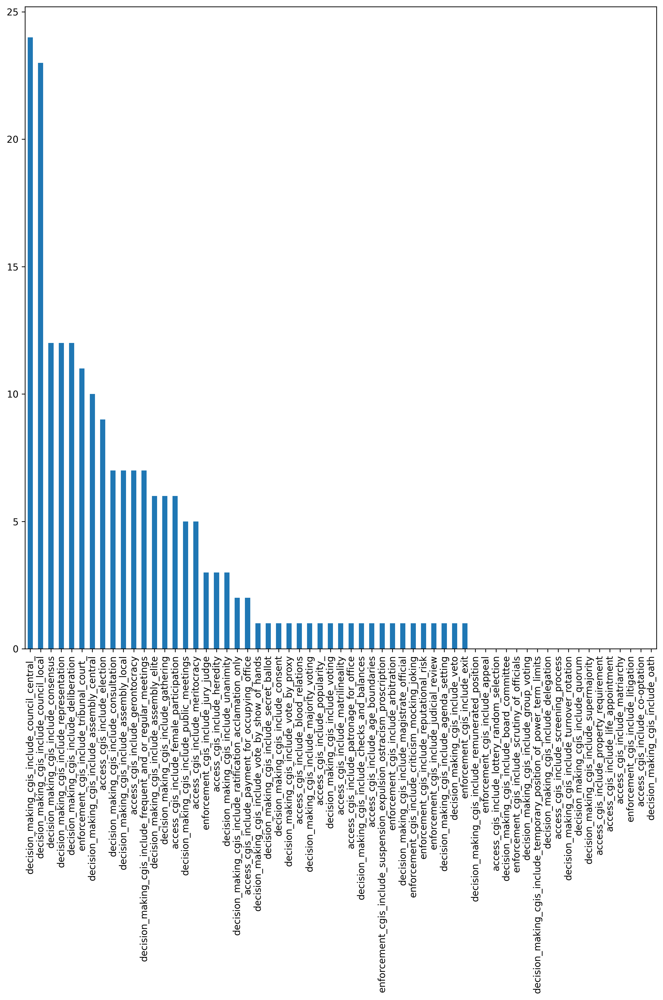

In [17]:
cgi_mechanisms_df.sum().sort_values(ascending=False).plot(kind='bar', figsize=(10,15))

plt.tight_layout()
plt.savefig(fig_dir + 'cgis_histogram.png')
plt.show()

TODO: 
  - comparative analysis b/n CGI mechanisms and non-CGI mechanisms

## By Mechanism category

In [18]:
access_cgis = [x for x in cgi_df.columns if 'access_cgis_' in x]

In [19]:
cgi_df[access_cgis]

,access_cgis_include_election,access_cgis_include_payment_for_occupying_office,access_cgis_include_screening_process,access_cgis_include_female_participation,access_cgis_include_matriarchy,access_cgis_include_heredity,access_cgis_include_co-optation,access_cgis_include_gerontocracy,access_cgis_include_life_appointment,access_cgis_include_property_requirement,access_cgis_include_blood_relations,access_cgis_include_popularity_,access_cgis_include_meritocracy,access_cgis_include_matrilineality,access_cgis_include_lottery_random_selection,access_cgis_include_patronage_for_office,access_cgis_include_age_boundaries
3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
5,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
6,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
7,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
8,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
9,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
10,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0
11,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
12,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


<Axes: >

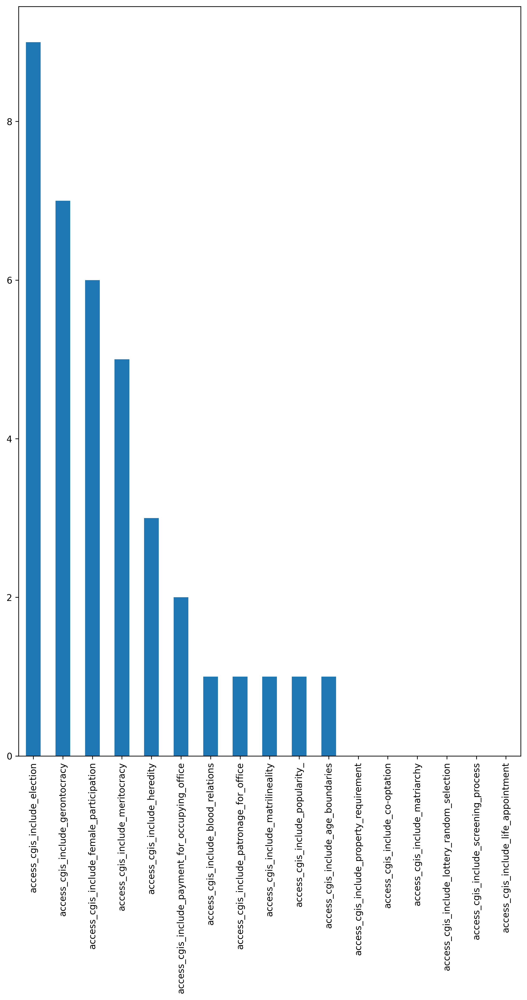

In [20]:
cgi_df[access_cgis].sum().sort_values(ascending=False).plot(kind='bar', figsize=(10,15))

In [21]:
decision_making_cgis = [x for x in cgi_df.columns if 'decision_making_cgis_' in x]

<Axes: >

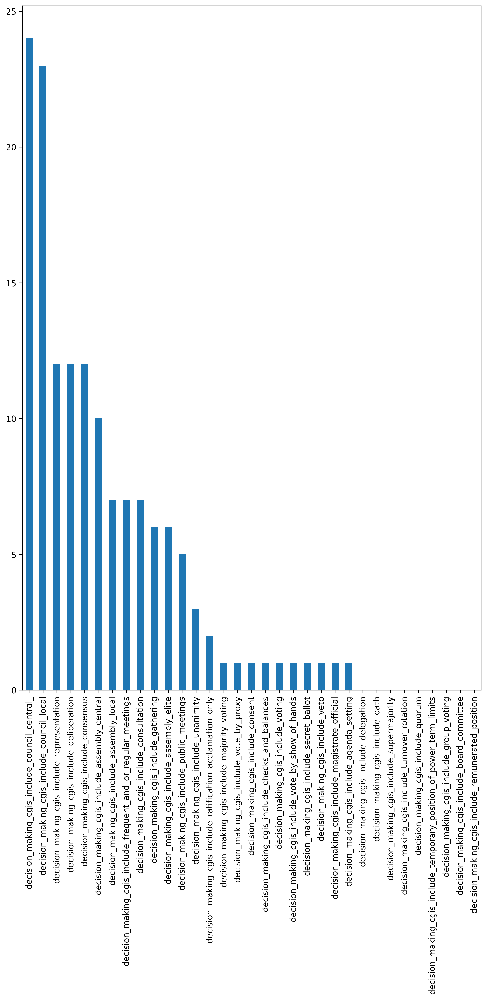

In [22]:
cgi_df[decision_making_cgis].sum().sort_values(ascending=False).plot(kind='bar', figsize=(10,15))

In [23]:
enforcement_cgis = [x for x in cgi_df.columns if 'enforcement_cgis_' in x]

<Axes: >

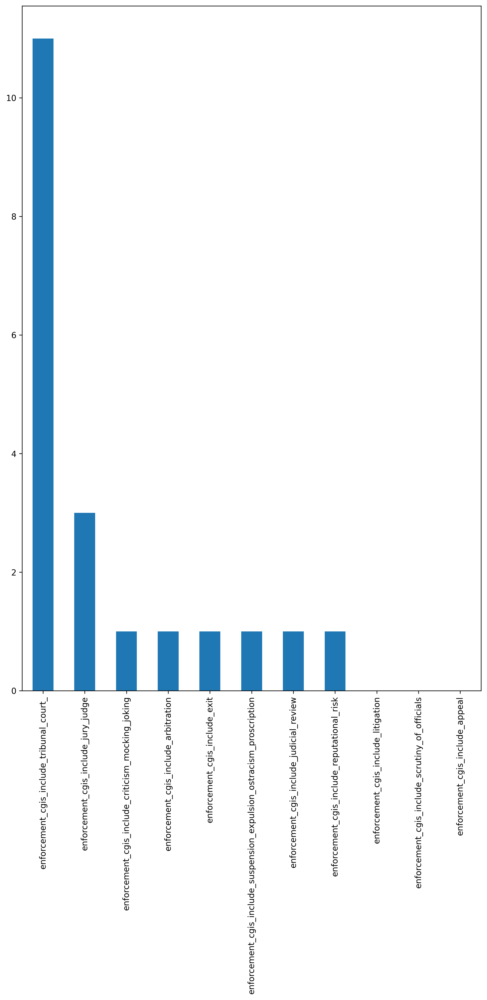

In [24]:
cgi_mechanisms_df[enforcement_cgis].sum().sort_values(ascending=False).plot(kind='bar', figsize=(10,15))

# CGI Mechanism Analysis 

In [25]:
# Select columns of interest

In [26]:
list(cgi_df)

['Institution_Name',
 'Community_Name',
 'Mechanism',
 'Notes',
 'Time span',
 'Geography',
 'Size',
 'Source',
 'Heterogeneity ',
 'Time span: Start',
 'Time span: End',
 'enforcement_mechanisms_include_graduated_sanctions',
 'access_mechanisms_include_dreaming',
 'decision_making_mechanisms_include_oath',
 'decision_making_mechanisms_include_board_committee',
 'enforcement_mechanisms_include_tribunal_court_',
 'enforcement_mechanisms_include_civil_disobedience',
 'decision_making_mechanisms_include_vote_by_show_of_hands',
 'decision_making_mechanisms_include_remunerated_position',
 'access_mechanisms_include_life_appointment',
 'decision_making_mechanisms_include_deliberation',
 'decision_making_mechanisms_include_assembly_local',
 'enforcement_mechanisms_include_mediation',
 'decision_making_mechanisms_include_leader_first_among_equals',
 'access_mechanisms_include_enfranchisement',
 'decision_making_mechanisms_include_autocratic_leader_chief_bound',
 'decision_making_mechanisms_inc

In [27]:
# Drop community mechanisms
mechanisms_list = [x for x in cgi_df.columns if x.startswith('mechanisms')]
mechanisms_list

['mechanisms_include_hered']

In [28]:
cgi_df.drop(columns=mechanisms_list, inplace=True)

In [29]:
list(cgi_df)

['Institution_Name',
 'Community_Name',
 'Mechanism',
 'Notes',
 'Time span',
 'Geography',
 'Size',
 'Source',
 'Heterogeneity ',
 'Time span: Start',
 'Time span: End',
 'enforcement_mechanisms_include_graduated_sanctions',
 'access_mechanisms_include_dreaming',
 'decision_making_mechanisms_include_oath',
 'decision_making_mechanisms_include_board_committee',
 'enforcement_mechanisms_include_tribunal_court_',
 'enforcement_mechanisms_include_civil_disobedience',
 'decision_making_mechanisms_include_vote_by_show_of_hands',
 'decision_making_mechanisms_include_remunerated_position',
 'access_mechanisms_include_life_appointment',
 'decision_making_mechanisms_include_deliberation',
 'decision_making_mechanisms_include_assembly_local',
 'enforcement_mechanisms_include_mediation',
 'decision_making_mechanisms_include_leader_first_among_equals',
 'access_mechanisms_include_enfranchisement',
 'decision_making_mechanisms_include_autocratic_leader_chief_bound',
 'decision_making_mechanisms_inc

## Normalized Correlation Matrix

In [30]:
data_plot = cgi_df.select_dtypes(include=[np.number])

In [31]:
data_plot.describe()

,Time span: Start,Time span: End,enforcement_mechanisms_include_graduated_sanctions,access_mechanisms_include_dreaming,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_board_committee,enforcement_mechanisms_include_tribunal_court_,enforcement_mechanisms_include_civil_disobedience,decision_making_mechanisms_include_vote_by_show_of_hands,decision_making_mechanisms_include_remunerated_position,access_mechanisms_include_life_appointment,decision_making_mechanisms_include_deliberation,decision_making_mechanisms_include_assembly_local,enforcement_mechanisms_include_mediation,decision_making_mechanisms_include_leader_first_among_equals,access_mechanisms_include_enfranchisement,decision_making_mechanisms_include_autocratic_leader_chief_bound,decision_making_mechanisms_include_assembly_central,decision_making_mechanisms_include_alliance,access_mechanisms_include_heredity,access_mechanisms_include_election,decision_making_mechanisms_include_magistrate_official,decision_making_mechanisms_include_ratification_acclamation_only,enforcement_mechanisms_include_reputational_risk,decision_making_mechanisms_include_veto,decision_making_mechanisms_include_unanimity,enforcement_mechanisms_include_criticism_mocking_joking,decision_making_mechanisms_include_agenda_setting,enforcement_mechanisms_include_fines,access_mechanisms_include_female_participation,enforcement_mechanisms_include_paying_damages_compensation,access_mechanisms_include_gerontocracy,decision_making_mechanisms_include_gathering,access_mechanisms_include_patronage_for_office,access_mechanisms_include_divine_right,access_mechanisms_include_matrilineality,decision_making_mechanisms_include_mandate,enforcement_mechanisms_include_destruction_of_property,enforcement_mechanisms_include_forced_labour,decision_making_mechanisms_include_quorum,enforcement_mechanisms_include_jury_judge,enforcement_mechanisms_include_appeal,decision_making_mechanisms_include_power_fluidity,enforcement_mechanisms_include_arbitration,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,enforcement_mechanisms_include_exit,decision_making_mechanisms_include_voting,decision_making_mechanisms_include_confederacy,enforcement_mechanisms_include_capital_punishment,decision_making_mechanisms_include_autocratic_leader_unbound,decision_making_mechanisms_include_consensus,decision_making_mechanisms_include_council_local,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_kingchief-as-figurehead,decision_making_mechanisms_include_majority_voting,access_mechanisms_include_open_political_unit,decision_making_mechanisms_include_checks_and_balances,decision_making_mechanisms_include_public_meetings,enforcement_mechanisms_include_self-help,decision_making_mechanisms_include_bureaucracy,decision_making_mechanisms_include_president_consul_chief_executive,access_mechanisms_include_matriarchy,access_mechanisms_include_lottery_random_selection,decision_making_mechanisms_include_consent,decision_making_mechanisms_include_vote_by_proxy,enforcement_mechanisms_include_police,decision_making_mechanisms_include_consultation,decision_making_mechanisms_include_assembly_elite,enforcement_mechanisms_include_monitoring,enforcement_mechanisms_include_corporal_punishment_violence_against_perpetrator,enforcement_mechanisms_include_negotiation,access_mechanisms_include_blood_relations,access_mechanisms_include_induction_rite_ceremony,decision_making_mechanisms_include_dual-sex_political_system,decision_making_mechanisms_include_representation,access_mechanisms_include_popularity_,decision_making_mechanisms_include_frequent_and_or_regular_meetings,decision_making_mechanisms_include_council_central_,decision_making_mechanisms_include_rule_of_law,enforcement_mechanisms_include_seizing_of_property,decision_making_mechanisms_include_constitution,decision_making_mechanisms_include_temporary_position_of_power_term_limits,decision_making_mechanisms_include_turnover_rotation,enforce

In [32]:
data_plot

,Time span: Start,Time span: End,enforcement_mechanisms_include_graduated_sanctions,access_mechanisms_include_dreaming,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_board_committee,enforcement_mechanisms_include_tribunal_court_,enforcement_mechanisms_include_civil_disobedience,decision_making_mechanisms_include_vote_by_show_of_hands,decision_making_mechanisms_include_remunerated_position,access_mechanisms_include_life_appointment,decision_making_mechanisms_include_deliberation,decision_making_mechanisms_include_assembly_local,enforcement_mechanisms_include_mediation,decision_making_mechanisms_include_leader_first_among_equals,access_mechanisms_include_enfranchisement,decision_making_mechanisms_include_autocratic_leader_chief_bound,decision_making_mechanisms_include_assembly_central,decision_making_mechanisms_include_alliance,access_mechanisms_include_heredity,access_mechanisms_include_election,decision_making_mechanisms_include_magistrate_official,decision_making_mechanisms_include_ratification_acclamation_only,enforcement_mechanisms_include_reputational_risk,decision_making_mechanisms_include_veto,decision_making_mechanisms_include_unanimity,enforcement_mechanisms_include_criticism_mocking_joking,decision_making_mechanisms_include_agenda_setting,enforcement_mechanisms_include_fines,access_mechanisms_include_female_participation,enforcement_mechanisms_include_paying_damages_compensation,access_mechanisms_include_gerontocracy,decision_making_mechanisms_include_gathering,access_mechanisms_include_patronage_for_office,access_mechanisms_include_divine_right,access_mechanisms_include_matrilineality,decision_making_mechanisms_include_mandate,enforcement_mechanisms_include_destruction_of_property,enforcement_mechanisms_include_forced_labour,decision_making_mechanisms_include_quorum,enforcement_mechanisms_include_jury_judge,enforcement_mechanisms_include_appeal,decision_making_mechanisms_include_power_fluidity,enforcement_mechanisms_include_arbitration,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,enforcement_mechanisms_include_exit,decision_making_mechanisms_include_voting,decision_making_mechanisms_include_confederacy,enforcement_mechanisms_include_capital_punishment,decision_making_mechanisms_include_autocratic_leader_unbound,decision_making_mechanisms_include_consensus,decision_making_mechanisms_include_council_local,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_kingchief-as-figurehead,decision_making_mechanisms_include_majority_voting,access_mechanisms_include_open_political_unit,decision_making_mechanisms_include_checks_and_balances,decision_making_mechanisms_include_public_meetings,enforcement_mechanisms_include_self-help,decision_making_mechanisms_include_bureaucracy,decision_making_mechanisms_include_president_consul_chief_executive,access_mechanisms_include_matriarchy,access_mechanisms_include_lottery_random_selection,decision_making_mechanisms_include_consent,decision_making_mechanisms_include_vote_by_proxy,enforcement_mechanisms_include_police,decision_making_mechanisms_include_consultation,decision_making_mechanisms_include_assembly_elite,enforcement_mechanisms_include_monitoring,enforcement_mechanisms_include_corporal_punishment_violence_against_perpetrator,enforcement_mechanisms_include_negotiation,access_mechanisms_include_blood_relations,access_mechanisms_include_induction_rite_ceremony,decision_making_mechanisms_include_dual-sex_political_system,decision_making_mechanisms_include_representation,access_mechanisms_include_popularity_,decision_making_mechanisms_include_frequent_and_or_regular_meetings,decision_making_mechanisms_include_council_central_,decision_making_mechanisms_include_rule_of_law,enforcement_mechanisms_include_seizing_of_property,decision_making_mechanisms_include_constitution,decision_making_mechanisms_include_temporary_position_of_power_term_limits,decision_making_mechanisms_include_turnover_rotation,enforce

In [33]:
normalized = Normalizer().fit_transform(data_plot)

norm_df = pd.DataFrame(normalized)
norm_df.columns = data_plot.columns
norm_corr = norm_df.corr()

norm_corr

,Time span: Start,Time span: End,enforcement_mechanisms_include_graduated_sanctions,access_mechanisms_include_dreaming,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_board_committee,enforcement_mechanisms_include_tribunal_court_,enforcement_mechanisms_include_civil_disobedience,decision_making_mechanisms_include_vote_by_show_of_hands,decision_making_mechanisms_include_remunerated_position,access_mechanisms_include_life_appointment,decision_making_mechanisms_include_deliberation,decision_making_mechanisms_include_assembly_local,enforcement_mechanisms_include_mediation,decision_making_mechanisms_include_leader_first_among_equals,access_mechanisms_include_enfranchisement,decision_making_mechanisms_include_autocratic_leader_chief_bound,decision_making_mechanisms_include_assembly_central,decision_making_mechanisms_include_alliance,access_mechanisms_include_heredity,access_mechanisms_include_election,decision_making_mechanisms_include_magistrate_official,decision_making_mechanisms_include_ratification_acclamation_only,enforcement_mechanisms_include_reputational_risk,decision_making_mechanisms_include_veto,decision_making_mechanisms_include_unanimity,enforcement_mechanisms_include_criticism_mocking_joking,decision_making_mechanisms_include_agenda_setting,enforcement_mechanisms_include_fines,access_mechanisms_include_female_participation,enforcement_mechanisms_include_paying_damages_compensation,access_mechanisms_include_gerontocracy,decision_making_mechanisms_include_gathering,access_mechanisms_include_patronage_for_office,access_mechanisms_include_divine_right,access_mechanisms_include_matrilineality,decision_making_mechanisms_include_mandate,enforcement_mechanisms_include_destruction_of_property,enforcement_mechanisms_include_forced_labour,decision_making_mechanisms_include_quorum,enforcement_mechanisms_include_jury_judge,enforcement_mechanisms_include_appeal,decision_making_mechanisms_include_power_fluidity,enforcement_mechanisms_include_arbitration,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,enforcement_mechanisms_include_exit,decision_making_mechanisms_include_voting,decision_making_mechanisms_include_confederacy,enforcement_mechanisms_include_capital_punishment,decision_making_mechanisms_include_autocratic_leader_unbound,decision_making_mechanisms_include_consensus,decision_making_mechanisms_include_council_local,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_kingchief-as-figurehead,decision_making_mechanisms_include_majority_voting,access_mechanisms_include_open_political_unit,decision_making_mechanisms_include_checks_and_balances,decision_making_mechanisms_include_public_meetings,enforcement_mechanisms_include_self-help,decision_making_mechanisms_include_bureaucracy,decision_making_mechanisms_include_president_consul_chief_executive,access_mechanisms_include_matriarchy,access_mechanisms_include_lottery_random_selection,decision_making_mechanisms_include_consent,decision_making_mechanisms_include_vote_by_proxy,enforcement_mechanisms_include_police,decision_making_mechanisms_include_consultation,decision_making_mechanisms_include_assembly_elite,enforcement_mechanisms_include_monitoring,enforcement_mechanisms_include_corporal_punishment_violence_against_perpetrator,enforcement_mechanisms_include_negotiation,access_mechanisms_include_blood_relations,access_mechanisms_include_induction_rite_ceremony,decision_making_mechanisms_include_dual-sex_political_system,decision_making_mechanisms_include_representation,access_mechanisms_include_popularity_,decision_making_mechanisms_include_frequent_and_or_regular_meetings,decision_making_mechanisms_include_council_central_,decision_making_mechanisms_include_rule_of_law,enforcement_mechanisms_include_seizing_of_property,decision_making_mechanisms_include_constitution,decision_making_mechanisms_include_temporary_position_of_power_term_limits,decision_making_mechanisms_include_turnover_rotation,enforce

In [34]:
norm_corr.head()

,Time span: Start,Time span: End,enforcement_mechanisms_include_graduated_sanctions,access_mechanisms_include_dreaming,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_board_committee,enforcement_mechanisms_include_tribunal_court_,enforcement_mechanisms_include_civil_disobedience,decision_making_mechanisms_include_vote_by_show_of_hands,decision_making_mechanisms_include_remunerated_position,access_mechanisms_include_life_appointment,decision_making_mechanisms_include_deliberation,decision_making_mechanisms_include_assembly_local,enforcement_mechanisms_include_mediation,decision_making_mechanisms_include_leader_first_among_equals,access_mechanisms_include_enfranchisement,decision_making_mechanisms_include_autocratic_leader_chief_bound,decision_making_mechanisms_include_assembly_central,decision_making_mechanisms_include_alliance,access_mechanisms_include_heredity,access_mechanisms_include_election,decision_making_mechanisms_include_magistrate_official,decision_making_mechanisms_include_ratification_acclamation_only,enforcement_mechanisms_include_reputational_risk,decision_making_mechanisms_include_veto,decision_making_mechanisms_include_unanimity,enforcement_mechanisms_include_criticism_mocking_joking,decision_making_mechanisms_include_agenda_setting,enforcement_mechanisms_include_fines,access_mechanisms_include_female_participation,enforcement_mechanisms_include_paying_damages_compensation,access_mechanisms_include_gerontocracy,decision_making_mechanisms_include_gathering,access_mechanisms_include_patronage_for_office,access_mechanisms_include_divine_right,access_mechanisms_include_matrilineality,decision_making_mechanisms_include_mandate,enforcement_mechanisms_include_destruction_of_property,enforcement_mechanisms_include_forced_labour,decision_making_mechanisms_include_quorum,enforcement_mechanisms_include_jury_judge,enforcement_mechanisms_include_appeal,decision_making_mechanisms_include_power_fluidity,enforcement_mechanisms_include_arbitration,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,enforcement_mechanisms_include_exit,decision_making_mechanisms_include_voting,decision_making_mechanisms_include_confederacy,enforcement_mechanisms_include_capital_punishment,decision_making_mechanisms_include_autocratic_leader_unbound,decision_making_mechanisms_include_consensus,decision_making_mechanisms_include_council_local,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_kingchief-as-figurehead,decision_making_mechanisms_include_majority_voting,access_mechanisms_include_open_political_unit,decision_making_mechanisms_include_checks_and_balances,decision_making_mechanisms_include_public_meetings,enforcement_mechanisms_include_self-help,decision_making_mechanisms_include_bureaucracy,decision_making_mechanisms_include_president_consul_chief_executive,access_mechanisms_include_matriarchy,access_mechanisms_include_lottery_random_selection,decision_making_mechanisms_include_consent,decision_making_mechanisms_include_vote_by_proxy,enforcement_mechanisms_include_police,decision_making_mechanisms_include_consultation,decision_making_mechanisms_include_assembly_elite,enforcement_mechanisms_include_monitoring,enforcement_mechanisms_include_corporal_punishment_violence_against_perpetrator,enforcement_mechanisms_include_negotiation,access_mechanisms_include_blood_relations,access_mechanisms_include_induction_rite_ceremony,decision_making_mechanisms_include_dual-sex_political_system,decision_making_mechanisms_include_representation,access_mechanisms_include_popularity_,decision_making_mechanisms_include_frequent_and_or_regular_meetings,decision_making_mechanisms_include_council_central_,decision_making_mechanisms_include_rule_of_law,enforcement_mechanisms_include_seizing_of_property,decision_making_mechanisms_include_constitution,decision_making_mechanisms_include_temporary_position_of_power_term_limits,decision_making_mechanisms_include_turnover_rotation,enforce

# Visualize and Sort CGI Correlations

In [35]:
plt.figure(figsize=(20,20))

# define the mask to set the values in the upper triangle to True
mask = np.triu(np.ones_like(norm_corr, dtype=np.bool))

triangle_heatmap = sns.heatmap(
    norm_corr, 
    mask=mask, 
    vmin=-1, 
    vmax=1, 
    annot=False, 
    cmap='BrBG', 
    xticklabels=1, 
    yticklabels=1)

triangle_heatmap.set_title('Triangle Correlation triangle_heatmap', fontdict={'fontsize':18}, pad=16);

plt.tight_layout()
plt.savefig(fig_dir + 'cgis_triangle_correlations.png')
plt.show()

/var/folders/v7/8x_7ty4j3m76hgg7tncks_kc0000gn/T/ipykernel_13224/3758718678.py:4: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  mask = np.triu(np.ones_like(norm_corr, dtype=np.bool))


In [ ]:
cgis_list = [x for x in cgi_df.columns if 'cgis_' in x]
cgis_list

In [ ]:
cgis_df = norm_corr[cgis_list]

In [38]:
cgis_df

,decision_making_cgis_include_secret_ballot,decision_making_cgis_include_consensus,decision_making_cgis_include_consultation,enforcement_cgis_include_criticism_mocking_joking,decision_making_cgis_include_board_committee,decision_making_cgis_include_group_voting,decision_making_cgis_include_temporary_position_of_power_term_limits,decision_making_cgis_include_gathering,enforcement_cgis_include_arbitration,decision_making_cgis_include_representation,access_cgis_include_election,decision_making_cgis_include_unanimity,access_cgis_include_payment_for_occupying_office,access_cgis_include_screening_process,decision_making_cgis_include_ratification_acclamation_only,decision_making_cgis_include_assembly_central,decision_making_cgis_include_turnover_rotation,access_cgis_include_female_participation,enforcement_cgis_include_exit,enforcement_cgis_include_suspension_expulsion_ostracism_proscription,decision_making_cgis_include_agenda_setting,enforcement_cgis_include_judicial_review,access_cgis_include_matriarchy,decision_making_cgis_include_council_central_,decision_making_cgis_include_assembly_elite,decision_making_cgis_include_assembly_local,enforcement_cgis_include_reputational_risk,decision_making_cgis_include_frequent_and_or_regular_meetings,enforcement_cgis_include_litigation,decision_making_cgis_include_magistrate_official,decision_making_cgis_include_oath,access_cgis_include_heredity,decision_making_cgis_include_veto,decision_making_cgis_include_delegation,decision_making_cgis_include_majority_voting,decision_making_cgis_include_public_meetings,access_cgis_include_co-optation,access_cgis_include_gerontocracy,decision_making_cgis_include_deliberation,decision_making_cgis_include_vote_by_show_of_hands,enforcement_cgis_include_tribunal_court_,access_cgis_include_life_appointment,access_cgis_include_property_requirement,decision_making_cgis_include_supermajority,decision_making_cgis_include_consent,decision_making_cgis_include_vote_by_proxy,decision_making_cgis_include_quorum,decision_making_cgis_include_council_local,access_cgis_include_blood_relations,decision_making_cgis_include_checks_and_balances,access_cgis_include_popularity_,access_cgis_include_meritocracy,decision_making_cgis_include_voting,enforcement_cgis_include_jury_judge,enforcement_cgis_include_scrutiny_of_officials,access_cgis_include_matrilineality,access_cgis_include_lottery_random_selection,enforcement_cgis_include_appeal,access_cgis_include_patronage_for_office,decision_making_cgis_include_remunerated_position,access_cgis_include_age_boundaries
Time span: Start,0.054438,0.158052,-0.043165,0.054325,NaN,NaN,NaN,0.060599,0.053967,0.119190,-0.018286,0.020198,0.042238,NaN,-0.019281,-0.172924,NaN,0.101140,0.043671,0.054325,0.033605,0.033605,NaN,-0.045807,-0.005777,-0.034217,0.032716,0.084407,NaN,0.047003,NaN,0.078000,0.053892,NaN,0.054325,-0.022406,NaN,0.130941,0.078127,0.054438,-0.053102,NaN,NaN,NaN,0.054438,0.053967,NaN,0.155396,0.032047,0.030836,0.051902,0.100632,0.039392,-0.180198,NaN,0.032716,NaN,NaN,0.051614,NaN,0.054438
Time span: End,0.041771,0.164272,-0.000037,0.041878,NaN,NaN,NaN,0.095198,0.042207,0.139125,0.014532,0.017282,0.073653,NaN,-0.026824,-0.126674,NaN,0.117825,0.048877,0.041878,0.051887,0.051887,NaN,-0.004535,0.025703,-0.023392,0.052035,0.081267,NaN,0.047218,NaN,0.080550,0.042275,NaN,0.041878,-0.006614,NaN,0.118353,0.095498,0.041771,-0.059065,NaN,NaN,NaN,0.041771,0.042207,NaN,0.152715,0.052136,0.052295,0.043956,0.104377,0.050482,-0.164958,NaN,0.052035,NaN,NaN,0.044180,NaN,0.041771
enforcement_mechanisms_include_graduated_sanctions,-0.004808,-0.016970,-0.011457,-0.004808,NaN,NaN,NaN,-0.010749,-0.004808,-0.016763,-0.011440,-0.008249,-0.006771,NaN,-0.006664,-0.012894,NaN,0.352611,-0.004808,-0.004808,-0.004808,-0.004808,NaN,0.116891,-0.011018,-0.011720,-0.004808,0.374878,NaN,-0.004808,NaN,-0.008314,-0.004808,NaN,-0.004808,0.300913,NaN,0.352591,-0.016886,-0.004808,-0.016110,NaN,NaN,NaN,-0.004808,-0.004808,NaN,-0.024025,-0.004808,-0.004808,-0.004808,-0.010753,

In [39]:
query_cgis_df = cgis_df.transpose()

In [40]:
query_cgis_df.head()

,Time span: Start,Time span: End,enforcement_mechanisms_include_graduated_sanctions,access_mechanisms_include_dreaming,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_board_committee,enforcement_mechanisms_include_tribunal_court_,enforcement_mechanisms_include_civil_disobedience,decision_making_mechanisms_include_vote_by_show_of_hands,decision_making_mechanisms_include_remunerated_position,access_mechanisms_include_life_appointment,decision_making_mechanisms_include_deliberation,decision_making_mechanisms_include_assembly_local,enforcement_mechanisms_include_mediation,decision_making_mechanisms_include_leader_first_among_equals,access_mechanisms_include_enfranchisement,decision_making_mechanisms_include_autocratic_leader_chief_bound,decision_making_mechanisms_include_assembly_central,decision_making_mechanisms_include_alliance,access_mechanisms_include_heredity,access_mechanisms_include_election,decision_making_mechanisms_include_magistrate_official,decision_making_mechanisms_include_ratification_acclamation_only,enforcement_mechanisms_include_reputational_risk,decision_making_mechanisms_include_veto,decision_making_mechanisms_include_unanimity,enforcement_mechanisms_include_criticism_mocking_joking,decision_making_mechanisms_include_agenda_setting,enforcement_mechanisms_include_fines,access_mechanisms_include_female_participation,enforcement_mechanisms_include_paying_damages_compensation,access_mechanisms_include_gerontocracy,decision_making_mechanisms_include_gathering,access_mechanisms_include_patronage_for_office,access_mechanisms_include_divine_right,access_mechanisms_include_matrilineality,decision_making_mechanisms_include_mandate,enforcement_mechanisms_include_destruction_of_property,enforcement_mechanisms_include_forced_labour,decision_making_mechanisms_include_quorum,enforcement_mechanisms_include_jury_judge,enforcement_mechanisms_include_appeal,decision_making_mechanisms_include_power_fluidity,enforcement_mechanisms_include_arbitration,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,enforcement_mechanisms_include_exit,decision_making_mechanisms_include_voting,decision_making_mechanisms_include_confederacy,enforcement_mechanisms_include_capital_punishment,decision_making_mechanisms_include_autocratic_leader_unbound,decision_making_mechanisms_include_consensus,decision_making_mechanisms_include_council_local,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_kingchief-as-figurehead,decision_making_mechanisms_include_majority_voting,access_mechanisms_include_open_political_unit,decision_making_mechanisms_include_checks_and_balances,decision_making_mechanisms_include_public_meetings,enforcement_mechanisms_include_self-help,decision_making_mechanisms_include_bureaucracy,decision_making_mechanisms_include_president_consul_chief_executive,access_mechanisms_include_matriarchy,access_mechanisms_include_lottery_random_selection,decision_making_mechanisms_include_consent,decision_making_mechanisms_include_vote_by_proxy,enforcement_mechanisms_include_police,decision_making_mechanisms_include_consultation,decision_making_mechanisms_include_assembly_elite,enforcement_mechanisms_include_monitoring,enforcement_mechanisms_include_corporal_punishment_violence_against_perpetrator,enforcement_mechanisms_include_negotiation,access_mechanisms_include_blood_relations,access_mechanisms_include_induction_rite_ceremony,decision_making_mechanisms_include_dual-sex_political_system,decision_making_mechanisms_include_representation,access_mechanisms_include_popularity_,decision_making_mechanisms_include_frequent_and_or_regular_meetings,decision_making_mechanisms_include_council_central_,decision_making_mechanisms_include_rule_of_law,enforcement_mechanisms_include_seizing_of_property,decision_making_mechanisms_include_constitution,decision_making_mechanisms_include_temporary_position_of_power_term_limits,decision_making_mechanisms_include_turnover_rotation,enforce

## Time x Region x Size for CGIs

In [41]:
time_span_cols = ['Time span: Start', 'Time span: End', 'Time span: Duration']

In [42]:
region_cols = [r for r in list(cgi_df) if 'Region: ' in r] 

In [43]:
size_cols = [
    'Size: 100 - 1,000',
    'Size: 1,001 - 10,000',
    'Size: 10,001 - 100,000',
    'Size: 100,001 - 1,000,000',
    'Size: 1,000,001 - 10,000,000',
    'Size: 10,000,000+',
    'Size: Unknown'
]

In [44]:
list(cgi_df.columns)

['Institution_Name',
 'Community_Name',
 'Mechanism',
 'Notes',
 'Time span',
 'Geography',
 'Size',
 'Source',
 'Heterogeneity ',
 'Time span: Start',
 'Time span: End',
 'enforcement_mechanisms_include_graduated_sanctions',
 'access_mechanisms_include_dreaming',
 'decision_making_mechanisms_include_oath',
 'decision_making_mechanisms_include_board_committee',
 'enforcement_mechanisms_include_tribunal_court_',
 'enforcement_mechanisms_include_civil_disobedience',
 'decision_making_mechanisms_include_vote_by_show_of_hands',
 'decision_making_mechanisms_include_remunerated_position',
 'access_mechanisms_include_life_appointment',
 'decision_making_mechanisms_include_deliberation',
 'decision_making_mechanisms_include_assembly_local',
 'enforcement_mechanisms_include_mediation',
 'decision_making_mechanisms_include_leader_first_among_equals',
 'access_mechanisms_include_enfranchisement',
 'decision_making_mechanisms_include_autocratic_leader_chief_bound',
 'decision_making_mechanisms_inc

## Time x CGIs

In [45]:
time_cgis = query_cgis_df[time_span_cols]
time_cgis

,Time span: Start,Time span: End,Time span: Duration
decision_making_cgis_include_secret_ballot,0.054438,0.041771,-0.056007
decision_making_cgis_include_consensus,0.158052,0.164272,-0.029826
decision_making_cgis_include_consultation,-0.043165,-0.000037,0.146581
enforcement_cgis_include_criticism_mocking_joking,0.054325,0.041878,-0.055292
decision_making_cgis_include_board_committee,NaN,NaN,NaN
decision_making_cgis_include_group_voting,NaN,NaN,NaN
decision_making_cgis_include_temporary_position_of_power_term_limits,NaN,NaN,NaN
decision_making_cgis_include_gathering,0.060599,0.095198,0.088050
enforcement_cgis_include_arbitration,0.053967,0.042207,-0.053061
decision_making_cgis_include_representation,0.119190,0.139125,0.024585


In [ ]:
plt.figure(figsize=(10,8))

sns.heatmap(time_cgis.sort_values(by='Time span: Duration', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'cgis_time.png')
plt.show()

### Time x CGIs: Access, Decision Making, Enforcement

In [ ]:
access_cgis

['access_cgis_include_election',
 'access_cgis_include_payment_for_occupying_office',
 'access_cgis_include_screening_process',
 'access_cgis_include_female_participation',
 'access_cgis_include_matriarchy',
 'access_cgis_include_heredity',
 'access_cgis_include_co-optation',
 'access_cgis_include_gerontocracy',
 'access_cgis_include_life_appointment',
 'access_cgis_include_property_requirement',
 'access_cgis_include_blood_relations',
 'access_cgis_include_popularity_',
 'access_cgis_include_meritocracy',
 'access_cgis_include_matrilineality',
 'access_cgis_include_lottery_random_selection',
 'access_cgis_include_patronage_for_office',
 'access_cgis_include_age_boundaries']

In [ ]:
time_access_cgis = time_cgis.loc[access_cgis]

In [49]:
time_access_cgis

,Time span: Start,Time span: End,Time span: Duration
access_cgis_include_election,-0.018286,0.014532,0.107020
access_cgis_include_payment_for_occupying_office,0.042238,0.073653,0.083912
access_cgis_include_screening_process,NaN,NaN,NaN
access_cgis_include_female_participation,0.101140,0.117825,0.020147
access_cgis_include_matriarchy,NaN,NaN,NaN
access_cgis_include_heredity,0.078000,0.080550,-0.016324
access_cgis_include_co-optation,NaN,NaN,NaN
access_cgis_include_gerontocracy,0.130941,0.118353,-0.079496
access_cgis_include_life_appointment,NaN,NaN,NaN
access_cgis_include_property_requirement,NaN,NaN,NaN


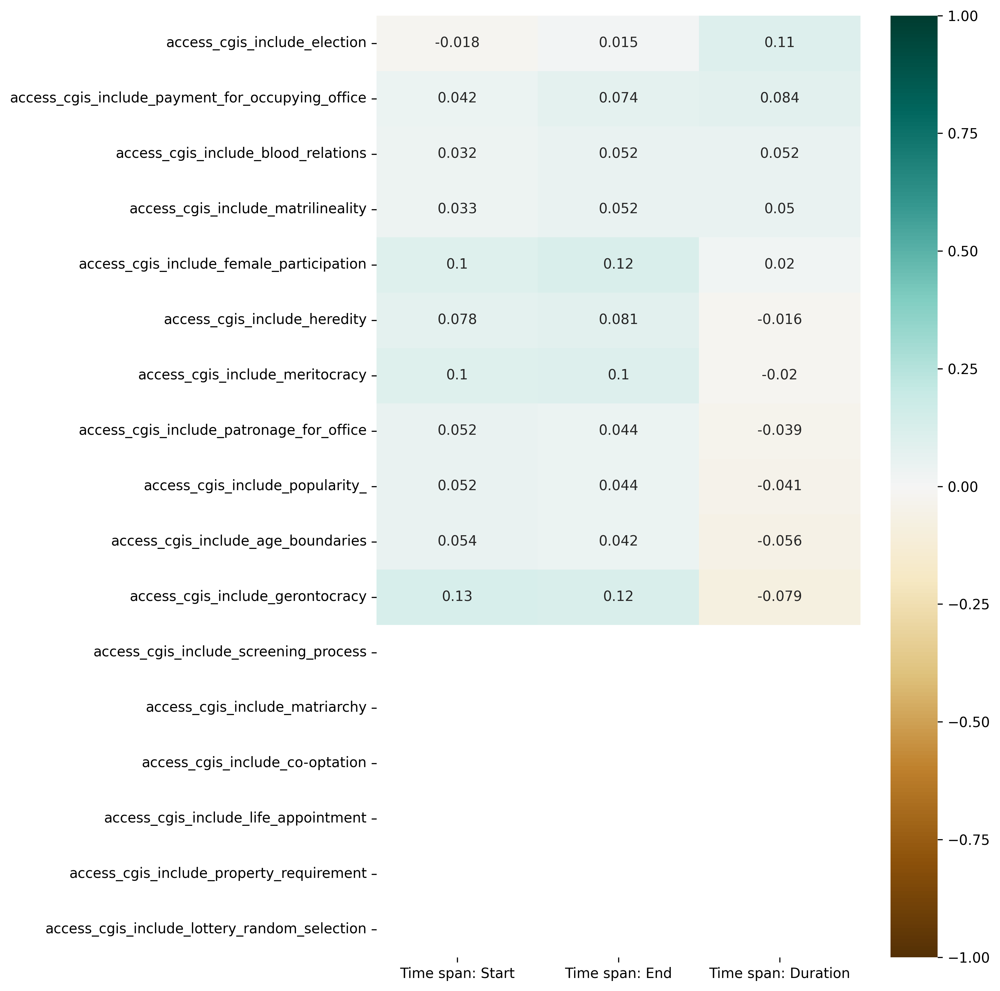

In [50]:
plt.figure(figsize=(10,10))

sns.heatmap(time_access_cgis.sort_values(by='Time span: Duration', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'time_access_cgis.png')
plt.show()

In [51]:
time_decision_making_cgis = time_cgis.loc[decision_making_cgis]

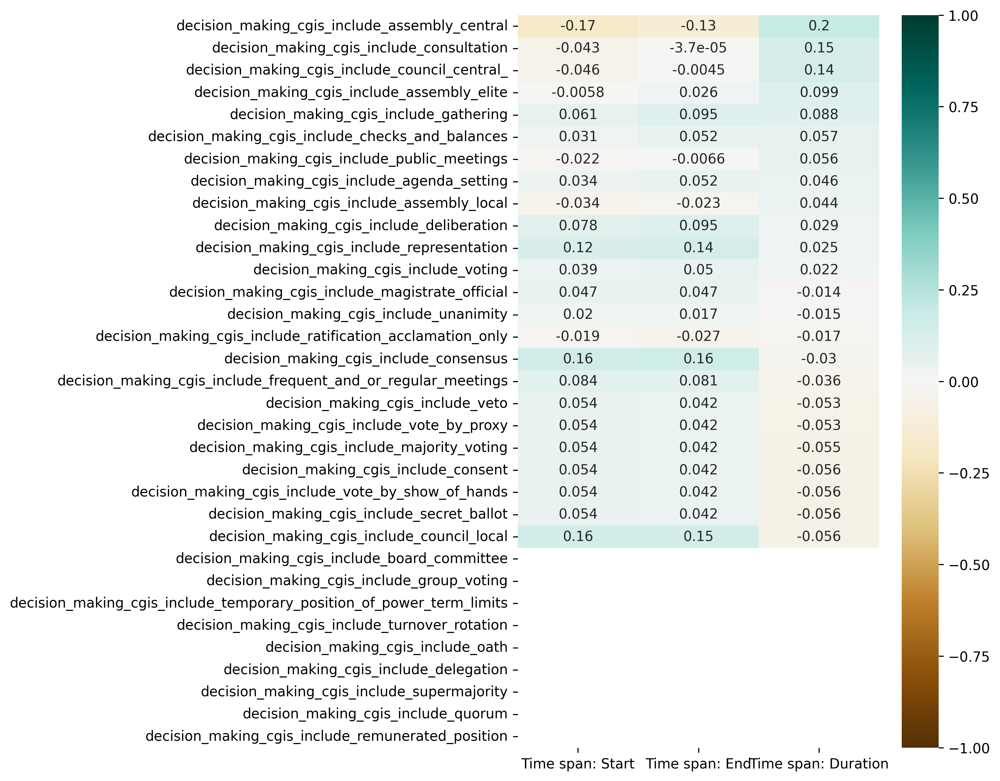

In [52]:
plt.figure(figsize=(10,8))

sns.heatmap(time_decision_making_cgis.sort_values(by='Time span: Duration', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'time_decision_making_cgis.png')
plt.show()

In [53]:
time_enforcement_cgis = time_cgis.loc[enforcement_cgis]

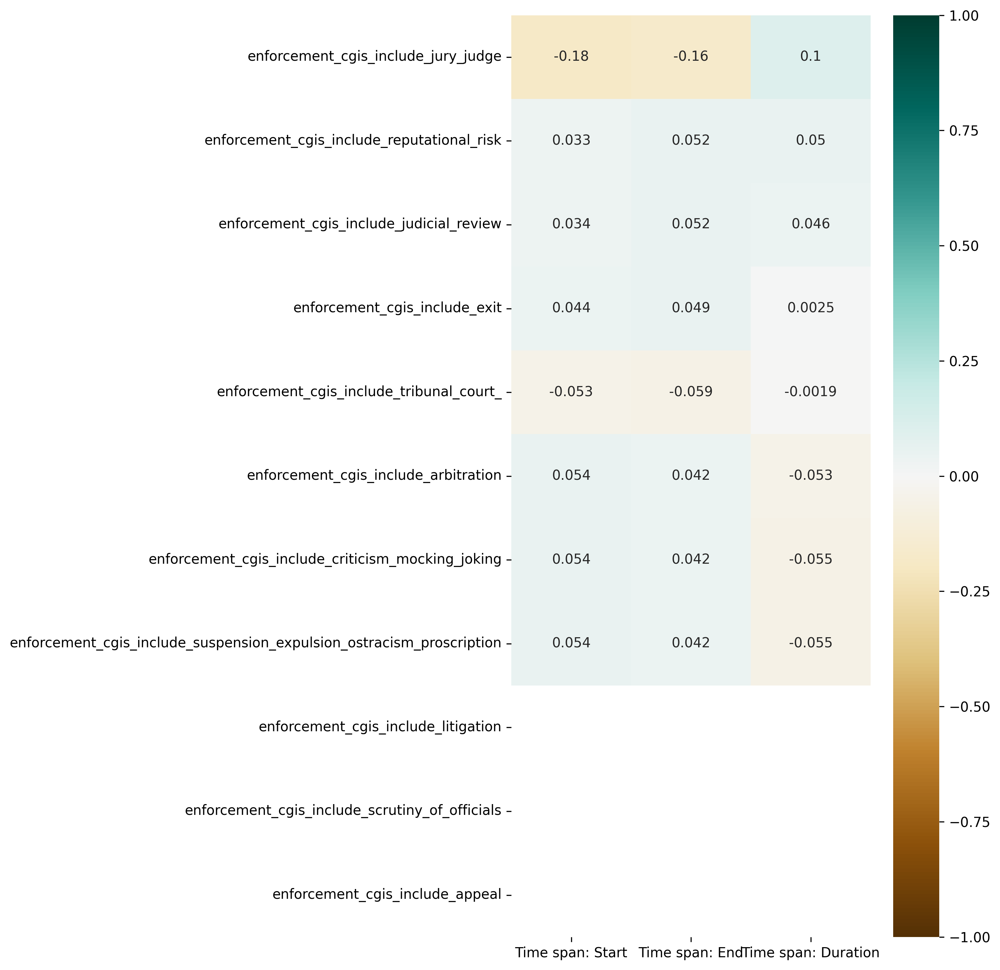

In [54]:
plt.figure(figsize=(10,10))

sns.heatmap(time_enforcement_cgis.sort_values(by='Time span: Duration', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'time_enforcement_cgis.png')
plt.show()

## Region x CGIs

In [55]:
region_cgis = query_cgis_df[region_cols]
region_cgis

,Region: Africa,Region: Europe,Region: Asia,Region: Middle East,Region: North America,Region: Central America,Region: South America,Region: Oceania
decision_making_cgis_include_secret_ballot,-0.026591,NaN,-0.043059,-0.031127,-0.032067,0.219208,-0.006816,-0.008367
decision_making_cgis_include_consensus,-0.034519,NaN,-0.008675,-0.109871,0.074643,0.054895,-0.024057,0.127551
decision_making_cgis_include_consultation,-0.063367,NaN,0.078321,0.158428,0.098922,-0.040180,-0.016241,-0.019940
enforcement_cgis_include_criticism_mocking_joking,-0.026591,NaN,0.065724,-0.031127,-0.032067,-0.016861,-0.006816,-0.008367
decision_making_cgis_include_board_committee,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
decision_making_cgis_include_group_voting,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
decision_making_cgis_include_temporary_position_of_power_term_limits,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
decision_making_cgis_include_gathering,-0.038883,NaN,-0.017079,0.197678,-0.021353,-0.037697,0.178595,-0.018707
enforcement_cgis_include_arbitration,-0.026591,NaN,0.059502,-0.031127,-0.032067,-0.016861,-0.006816,-0.008367
decision_making_cgis_include_representation,0.026078,NaN,0.060595,-0.108530,-0.006013,-0.058790,-0.023763,-0.029175


In [56]:
# Move Region: Europe to first col 
cols_to_move = ['Region: Europe']
region_cgis = region_cgis[cols_to_move + [col for col in region_cgis.columns if col not in cols_to_move ]]

In [ ]:
plt.figure(figsize=(20,15))

sns.heatmap(region_cgis.sort_values(by='Region: Europe', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'cgis_region.png')
plt.show()

### Region x CGIs: Access, Decision Making, Enforcement

In [ ]:
region_access_cgis = region_cgis.loc[access_cgis]

In [ ]:
plt.figure(figsize=(10,8))

sns.heatmap(region_access_cgis.sort_values(by='Region: Europe', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'region_access_cgis.png')
plt.show()

In [60]:
region_decision_making_cgis = region_cgis.loc[decision_making_cgis]

In [ ]:
plt.figure(figsize=(20,15))

sns.heatmap(region_decision_making_cgis.sort_values(by='Region: Europe', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'region_decision_making_cgis.png')
plt.show()

In [ ]:
region_enforcement_cgis = region_cgis.loc[enforcement_cgis]

In [ ]:
plt.figure(figsize=(10,8))

sns.heatmap(region_enforcement_cgis.sort_values(by='Region: Europe', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'region_enforcement_cgis.png')
plt.show()

## Size x CGIs

In [ ]:
size_cgis = query_cgis_df[size_cols]

In [ ]:
plt.figure(figsize=(20,15))

sns.heatmap(size_cgis,
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'cgis_size.png')
plt.show()

### Size x CGIs: Access, Decision Making, Enforcement

In [66]:
size_access_cgis = size_cgis.loc[access_cgis]

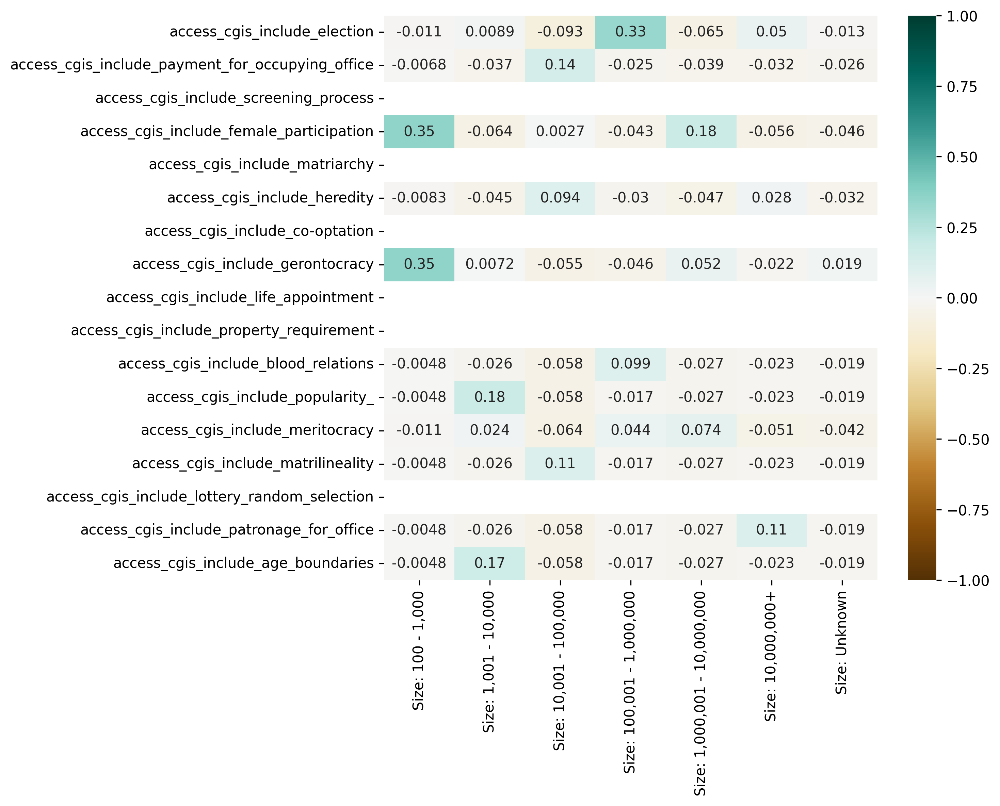

In [67]:
plt.figure(figsize=(10,8))

sns.heatmap(size_access_cgis,
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'size_access_cgis.png')
plt.show()

In [68]:
size_decision_making_cgis = size_cgis.loc[decision_making_cgis]

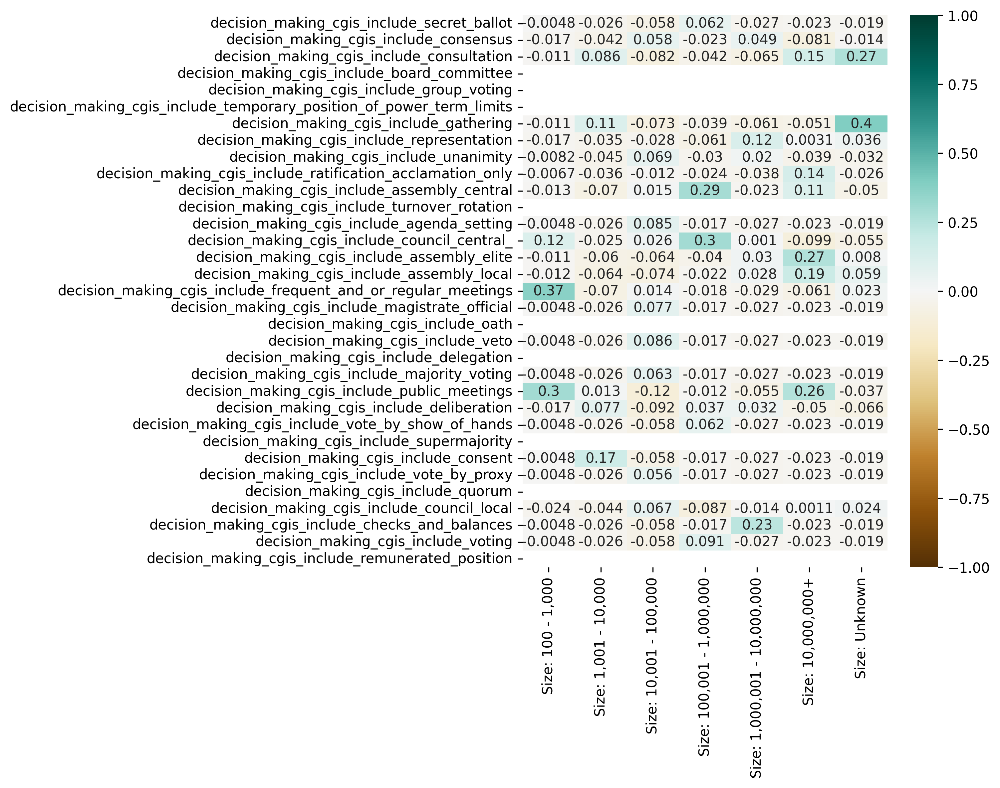

In [69]:
plt.figure(figsize=(10,8))

sns.heatmap(size_decision_making_cgis,
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'size_decision_making_cgis.png')
plt.show()

In [70]:
size_enforcement_cgis = size_cgis.loc[enforcement_cgis]

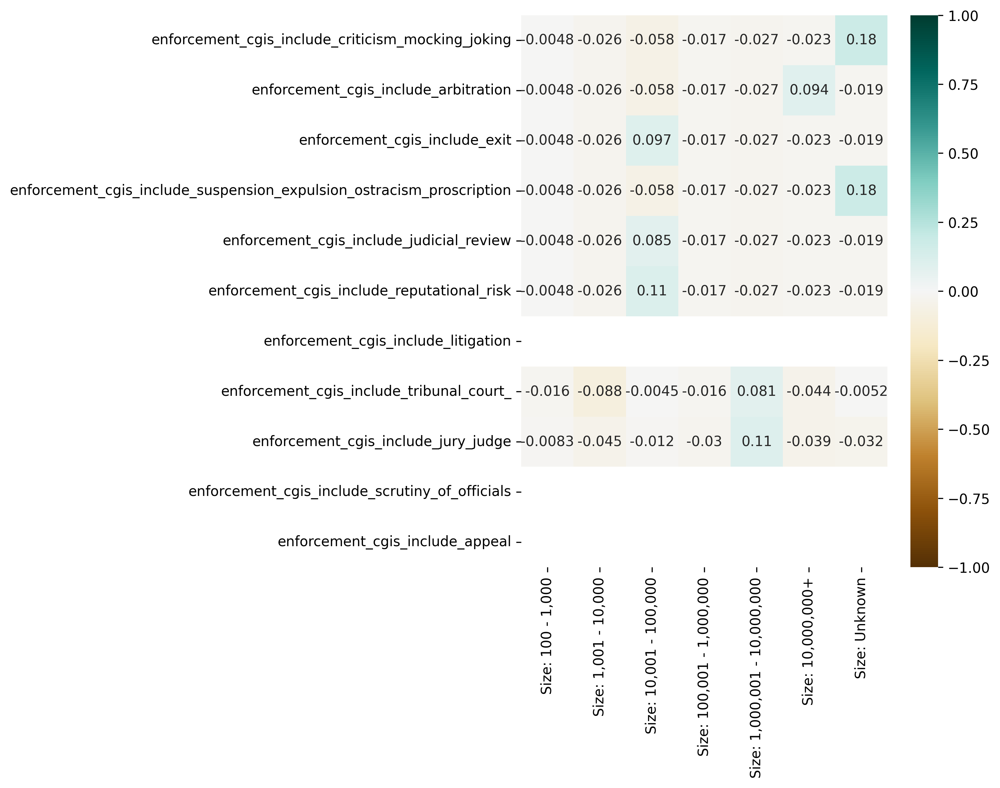

In [71]:
plt.figure(figsize=(10,8))

sns.heatmap(size_enforcement_cgis,
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'size_enforcement_cgis.png')
plt.show()

# Sorted positive and negative correlations

In [72]:
def get_redundant_pairs(df):
    '''Get diagonal and lower triangular pairs of correlation matrix'''
    pairs_to_drop = set()
    cols = df.columns
    for i in range(0, df.shape[1]):
        for j in range(0, i+1):
            pairs_to_drop.add((cols[i], cols[j]))
    return pairs_to_drop

In [73]:
def get_sorted_correlations(corr_df, n=100, ascending=False):
    au_corr = corr_df.unstack()
    labels_to_drop = get_redundant_pairs(corr_df)
    au_corr = au_corr.drop(labels=labels_to_drop).sort_values(ascending=ascending)
    return au_corr

In [74]:
# Highest 200 positively correlated variables
print(get_sorted_correlations(norm_corr, n=200, ascending=False))

enforcement_mechanisms_include_litigation          Geography: Africa North                                                 1.0
enforcement_mechanisms_include_forced_labour       decision_making_mechanisms_include_bureaucracy                          1.0
enforcement_mechanisms_include_civil_disobedience  Geography: North America, Louisiana                                     1.0
decision_making_mechanisms_include_mandate         Geography: Middle East, Mesopotamia, Babylonia                          1.0
enforcement_cgis_include_criticism_mocking_joking  enforcement_cgis_include_suspension_expulsion_ostracism_proscription    1.0
                                                                                                                          ... 
enforcement_cgis_include_appeal                    access_cgis_include_patronage_for_office                                NaN
                                                   decision_making_cgis_include_remunerated_position           

In [75]:
get_sorted_correlations(norm_corr, n=200, ascending=False).to_csv('../csv/' + DATA_VERSION + '/cgis_all_correlations.csv')

In [76]:
# Highest 200 negatively correlated variables 
print(get_sorted_correlations(norm_corr, n=200, ascending=True))

Time span: End                                     enforcement_mechanisms_include_jury_judge           -0.653178
                                                   Region: Middle East                                 -0.641134
Time span: Start                                   enforcement_mechanisms_include_jury_judge           -0.633536
Time span: End                                     Geography: Middle East                              -0.607969
Time span: Start                                   Region: Middle East                                 -0.592534
                                                                                                          ...   
enforcement_cgis_include_appeal                    access_cgis_include_patronage_for_office                  NaN
                                                   decision_making_cgis_include_remunerated_position         NaN
                                                   access_cgis_include_age_boundaries           

In [77]:
get_sorted_correlations(norm_corr, n=200, ascending=True).to_csv('../csv/' + DATA_VERSION + '/cgis_negative_correlations.csv')